In [ ]:
!pip install natsort
!pip install wandb 

In [11]:
# !git clone https://github.com/Hassan-Tamer/pattern-Assignments.git
!git checkout multitask
# %cd pattern-Assignments/lab2

Branch 'multitask' set up to track remote branch 'multitask' from 'origin'.
Switched to a new branch 'multitask'


In [12]:
%cd pattern-Assignments/lab2

[Errno 2] No such file or directory: 'pattern-Assignments/lab2'
/kaggle/working/pattern-Assignments/lab2


In [13]:
!ls /kaggle/working/pattern-Assignments/lab2

Preprocessing.ipynb		  main.py
__pycache__			  model.py
classification-and-segment.ipynb  multitask-cleaned.ipynb
data-leakage.ipynb		  remaining_image_paths.txt
dataset.py			  removed_images.txt
deeplab.ipynb			  requirement.txt
evaluation.py			  train.py


In [15]:
import torch
import torch.nn as nn
import torch.optim as optim
from model import *
import wandb
from evaluation import *
from train import *
import wandb

In [16]:
lr = 1e-4
batch_size = 4
epochs = 3
wandb.init(project="ham10000-classification", config={
    "learning_rate": lr,
    "epochs": epochs,
    "batch_size": batch_size,
    "optimizer": "Adam"
})

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [21]:
import os 
from natsort import natsorted
from PIL import Image
from torch.utils.data import Dataset
from torchvision import transforms
from sklearn.model_selection import train_test_split
import pandas as pd

class HAM10000(Dataset):
    def __init__(self, data, transform=None):
        self.data = data
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image, mask , label = self.data[idx]

        to_tensor = transforms.ToTensor()
        if self.transform:
            image = self.transform(image)
            mask = to_tensor(mask) 
        else:
            image = to_tensor(image)
            mask = to_tensor(mask)

        mask = mask.squeeze(0)  # Remove channel dimension if present
        mask = mask.long()      # Convert to integer for class indices

        return image, mask , label

def get_labels_df(img_name,labels_df):
    img_name = img_name.split('.')[0]
    label = labels_df.loc[labels_df['image'] == img_name, 'label'].values[0]
    return label

def preload_ham10000(root,labels_df,val_size=0.2, seed=42 , max_samples=None,removed_path = "/kaggle/working/pattern-Assignments/lab2/removed_images.txt"):
    imgs_path = os.path.join(root, 'images')
    masks_path = os.path.join(root, 'masks')

    image_files = []
    mask_files = []

    with open(removed_path, 'r') as file:
        removed_basenames = {os.path.basename(line.strip()).split('.')[0] for line in file}

    for i,f in enumerate(os.listdir(imgs_path)):
        if f.endswith(('.jpg', '.png')):
            basename = f.split('.')[0]
            if basename not in removed_basenames:
                image_files.append(f)
        
        if max_samples is not None and i >= max_samples:
            break
    
    for i,f in enumerate(os.listdir(masks_path)):
        if f.endswith(('.jpg', '.png')):
            basename = f.split('_segmentation')[0]  # Match mask base name to image base name
            if basename not in removed_basenames:
                mask_files.append(f)

        if max_samples is not None and i >= max_samples:
            break

    image_files = natsorted(image_files)
    mask_files = natsorted(mask_files)

    assert len(image_files) == len(mask_files), "Mismatch between image and mask counts."

    all_data = []
    i=0
    for img_file, mask_file in zip(image_files, mask_files):
        if max_samples is not None and i >= max_samples:
            break
        img = Image.open(os.path.join(imgs_path, img_file)).convert("RGB")
        mask = Image.open(os.path.join(masks_path, mask_file)).convert("L")
        label = get_labels_df(img_file,labels_df)
        all_data.append((img, mask, label))

    if val_size == 0:
        return all_data, None

    train_data, val_data = train_test_split(all_data, test_size=val_size, random_state=seed)
    return train_data, val_data


In [23]:
def get_dataset_loaders(dataset_root,batch_size=4,val_size=0.2,max_samples=None):
    print("Loading dataset...")

    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    df = pd.read_csv(os.path.join(dataset_root, 'GroundTruth.csv'))

    df['label'] = df.iloc[:, 1:].idxmax(axis=1).map({
        'MEL': 0,
        'NV': 1,
        'BCC': 2,
        'AKIEC': 3,
        'BKL': 4,
        'DF': 5,
        'VASC': 6
    })
    df = df.drop(columns=['MEL','NV','BCC','AKIEC','BKL','DF','VASC'])

    train_data, val_data = preload_ham10000(dataset_root,df, val_size=val_size,max_samples=max_samples)

    train_dataset = HAM10000(data=train_data, transform=preprocess)
    val_dataset = HAM10000(data=val_data, transform=preprocess)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    print(f"Train size: {len(train_loader)}")
    print(f"Test size: {len(val_loader)}")

    return train_loader, val_loader

In [70]:
from torch.utils.data import Subset, DataLoader
indices_1 = list(range(0, 400))  # First subset: indices 0 to 99
subset_1 = Subset(train_loader.dataset, indices_1)
train_loader_1 = DataLoader(subset_1, batch_size=train_loader.batch_size, shuffle=True)


In [72]:
len(train_loader_1)

100

In [65]:
dataset_root = '/kaggle/input/ham1000-segmentation-and-classification'
train_loader , val_loader = get_dataset_loaders(dataset_root, batch_size=batch_size)

Loading dataset...


KeyboardInterrupt: 

In [26]:
def load_model():
    model = torch.hub.load('pytorch/vision:v0.10.0', 'deeplabv3_resnet50', pretrained=True)

    pytorch_total_params = sum(p.numel() for p in model.parameters())
    formatted_number = f"{pytorch_total_params:,}"
    print(f"Total number of parameters in the model: {formatted_number}")
    
    num_classes = 2 
    model.classifier[4] = torch.nn.Conv2d(256, num_classes, kernel_size=1)
    
    return model

class simple_classifier(torch.nn.Module):
    def __init__(self):
        super(simple_classifier, self).__init__()
        self.conv1 = nn.Conv2d(2048, 512, kernel_size=3, padding=1,stride=2)
        self.bn1 = nn.BatchNorm2d(512)
        self.conv2 = nn.Conv2d(512, 64, kernel_size=3, padding=1,stride=2)
        self.bn2 = nn.BatchNorm2d(64)
        self.flatten = nn.Flatten()
        self.fc = nn.Linear(64*15*19, 7)
        self.relu = nn.ReLU()
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        x = self.flatten(x)
        logits = self.fc(x)
        return logits


class deeplabv3_Multitask(torch.nn.Module):
    def __init__(self):
        super(deeplabv3_Multitask, self).__init__()
        self.deeplab = load_model()
        self.clsfr = simple_classifier()
        
    def forward(self, x):
        features = self.deeplab.backbone(x)
        
        out_features = features['out']
        aux_features = features['aux']        
        classification = self.clsfr(out_features)
        
        out = self.deeplab.classifier(out_features)      
        out = torch.nn.functional.interpolate(out, size=x.shape[2:], mode='bilinear', align_corners=False)  
        aux = self.deeplab.aux_classifier(aux_features)
        aux = torch.nn.functional.interpolate(aux, size=x.shape[2:], mode='bilinear', align_corners=False)
        

        return {'out': out, 'aux': aux, 'classification': classification}

In [27]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model = deeplabv3_Multitask()
criterion = nn.CrossEntropyLoss() 
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=lr)

model.to(device)
criterion.to(device)
class_criterion.to(device)

num_epochs = epochs
best_val_acc = 0.0
patience = 3
epochs_without_improvement = 0
checkpoint_path = "best_model.pth"

Using device: cuda


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth
100%|██████████| 161M/161M [00:00<00:00, 216MB/s] 


Total number of parameters in the model: 42,004,074


In [35]:
def train_one_epoch(model, train_loader, criterion, class_criterion,optimizer, device,epoch):
    model.train()
    running_loss = 0.0
    num_batches = len(train_loader)

    for i, data in enumerate(tqdm(train_loader)):
        inputs, masks,label = data
        inputs, masks,label = inputs.to(device), masks.to(device), label.to(device)
        optimizer.zero_grad()
        outputs_seg = model(inputs)['out']
        loss_seg = criterion(outputs_seg, masks)
        outputs_cls = model(inputs)['classification']
        loss_cls = class_criterion(outputs_cls, label)
        loss = loss_seg + loss_cls
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        if (i + 1) % 40 == 0 or (i + 1) == num_batches:
            avg_loss_so_far = running_loss / (i + 1)
            wandb.log({
                "train/loss_seg": loss_seg.item(),
                "train/loss_cls": loss_cls.item(),
                "train/loss": loss.item(),
                "train/avg_loss_so_far": avg_loss_so_far,
                "train/progress": (i + 1) / num_batches,
                "train/batch": i + 1 + epoch * num_batches
            })

    avg_loss = running_loss / len(train_loader)
    wandb.log({"train/epoch_loss": avg_loss, "epoch": epoch})
    return avg_loss

In [74]:
def evaluate_one_epoch(model,val_loader,criterion,class_criterion,device,epoch):
    model.eval()
    correct_seg = 0
    correct_cls = 0
    total = 0
    val_loss = 0.0
    num_batches = len(val_loader)

    with torch.no_grad():
        for i,data in enumerate(tqdm(val_loader)):
            if i > 50:
                break
            inputs, masks , label= data
            inputs, masks , label= inputs.to(device), masks.to(device), label.to(device)
            outputs_seg = model(inputs)['out']

            # Resize outputs to match mask dimensions
            outputs_seg = F.interpolate(outputs_seg, size=masks.shape[1:], mode="bilinear", align_corners=False)
            loss_seg = criterion(outputs_seg, masks)

            outputs_cls = model(inputs)['classification']
            loss_cls = class_criterion(outputs_cls, label)
            
            loss = loss_seg + loss_cls
            val_loss += loss.item()

            preds = torch.argmax(outputs_seg, dim=1)
            correct_seg += (preds == masks).sum().item()
            total += masks.numel()

            preds_cls = torch.argmax(outputs_cls, dim=1)
            correct_cls += (preds_cls == label).sum().item()

            if (i + 1) % 10 == 0 or (i + 1) == num_batches:
                wandb.log({
                    "val/loss_seg": loss_seg.item(),
                    "val/loss_cls": loss_cls.item(),
                    "val/loss": loss.item(),
                    "val/progress": (i + 1) / num_batches,
                    "val/batch": i + 1 + epoch * num_batches,
                    "val/seg_accuracy": correct_seg / total if total > 0 else 0,
                    "val/cls_accuracy": correct_cls / ((i + 1) * val_loader.batch_size),
                })
        
    return val_loss, correct_seg, correct_cls, total

In [78]:
for epoch in range(epochs):
        avg_loss = train_one_epoch(model, train_loader_1, criterion, class_criterion, optimizer, device,epoch)
        print(f"Epoch {epoch+1}, loss: {avg_loss}")
        
        # wandb.log({"train_loss": avg_loss})

        val_loss, correct_seg, correct_cls, total = evaluate_one_epoch(model, val_loader, criterion, class_criterion, device,epoch)
        val_loss /= len(val_loader)
        val_acc_seg = correct_seg / total * 100
        val_acc_cls = correct_cls / len(val_loader.dataset) * 100
        print(f"Epoch {epoch + 1}, Val Loss: {val_loss:.4f}, Val Accuracy: {val_acc_seg:.2f}% (seg), {val_acc_cls:.2f}% (cls)")
        
        wandb.log({"val_loss": val_loss, "val_accuracy": val_acc_seg, "val_accuracy_cls": val_acc_cls})

        if val_acc_seg > best_val_acc:
            best_val_acc = val_acc_seg
            # save_checkpoint(model, optimizer, epoch + 1, best_val_acc, checkpoint_path)
            epochs_without_improvement = 0
        else:
            epochs_without_improvement += 1
            print(f"No improvement for {epochs_without_improvement} epoch(s).")

        if epochs_without_improvement >= patience:
            print("Early stopping triggered.")
            break

  8%|▊         | 8/100 [00:12<02:20,  1.53s/it]


KeyboardInterrupt: 

In [76]:
val_loss, correct_seg, correct_cls, total = evaluate_one_epoch(model, val_loader, criterion, class_criterion, device,epoch)
val_loss /= len(val_loader)
val_acc_seg = correct_seg / total * 100
val_acc_cls = correct_cls / len(val_loader.dataset) * 100
print(f"Epoch {epoch + 1}, Val Loss: {val_loss:.4f}, Val Accuracy: {val_acc_seg:.2f}% (seg), {val_acc_cls:.2f}% (cls)")

wandb.log({"val_loss": val_loss, "val_accuracy": val_acc_seg, "val_accuracy_cls": val_acc_cls})

if val_acc_seg > best_val_acc:
    best_val_acc = val_acc_seg
    # save_checkpoint(model, optimizer, epoch + 1, best_val_acc, checkpoint_path)
    epochs_without_improvement = 0
else:
    epochs_without_improvement += 1
    print(f"No improvement for {epochs_without_improvement} epoch(s).")

# if epochs_without_improvement >= patience:
#     print("Early stopping triggered.")
#     break

 12%|█▏        | 51/423 [00:26<03:10,  1.95it/s]

Epoch 2, Val Loss: 0.1023, Val Accuracy: 94.63% (seg), 8.98% (cls)
No improvement for 3 epoch(s).


In [62]:
!ls

Preprocessing.ipynb		  deeplab.ipynb		     removed_images.txt
__pycache__			  evaluation.py		     requirement.txt
best_model.pth			  main.py		     train.py
classification-and-segment.ipynb  model.py		     wandb
data-leakage.ipynb		  multitask-cleaned.ipynb
dataset.py			  remaining_image_paths.txt


In [ ]:
wandb.finish

In [45]:
import torch
from matplotlib import pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

def dice_score(pred, target):
    pred = pred.flatten()
    target = target.flatten()

    intersection = (pred * target).sum()
    dice = (2. * intersection + 1e-6) / (pred.sum() + target.sum() + 1e-6)  # Adding epsilon to avoid division by 0

    return dice.item()

def calculateIOU(pred, target):
    pred = pred.flatten()
    target = target.flatten()

    intersection = (pred * target).sum()
    union = pred.sum() + target.sum() - intersection

    return (intersection + 1e-6) / (union + 1e-6)  

def display_segmentation_examples(inputs, masks, outputs, num_examples=3):
    fig, axes = plt.subplots(num_examples, 3, figsize=(12, 4 * num_examples))
    for i in range(num_examples):
        ax = axes[i]
        
        # Original image
        ax[0].imshow(inputs[i].cpu().numpy().transpose(1, 2, 0))  # Convert to HWC format
        ax[0].set_title("Input Image")
        ax[0].axis('off')
        
        # Ground truth mask
        ax[1].imshow(masks[i].cpu().numpy(), cmap='gray')
        ax[1].set_title("Ground Truth")
        ax[1].axis('off')
        
        # Predicted mask
        pred_mask = torch.argmax(outputs[i], dim=0)  # Take the class with the highest probability
        ax[2].imshow(pred_mask.cpu().numpy(), cmap='gray')
        ax[2].set_title("Prediction")
        ax[2].axis('off')
    
    plt.tight_layout()
    plt.show()

   

def evaluate_classifier(val_loader, model, device, class_criterion):
    model.eval()  # Set the model to evaluation mode
    
    all_preds = []
    all_labels = []
    total_loss = 0.0
    total_samples = 0
    
    with torch.no_grad():  # Disable gradient calculation
        for inputs, _, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            # Forward pass through the classifier
            outputs_cls = model(inputs)['classification']
            loss_cls = class_criterion(outputs_cls, labels)
            
            total_loss += loss_cls.item() * labels.size(0)  # Sum up batch loss
            total_samples += labels.size(0)

            _, predicted = torch.max(outputs_cls, 1)
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    avg_loss = total_loss / total_samples  # Calculate average loss
    
    # Compute metrics
    conf_matrix = confusion_matrix(all_labels, all_preds)
    report = classification_report(all_labels, all_preds, output_dict=True)
    accuracy = report["accuracy"] * 100
    precision = report["weighted avg"]["precision"]
    recall = report["weighted avg"]["recall"]
    f1_score = report["weighted avg"]["f1-score"]
    
    print("Confusion Matrix:")
    plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()
    print(f"Validation Loss: {avg_loss:.4f}")
    print(f"Accuracy: {accuracy:.2f}%")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1_score:.4f}")
    
    return avg_loss, accuracy, precision, recall, f1_score, conf_matrix


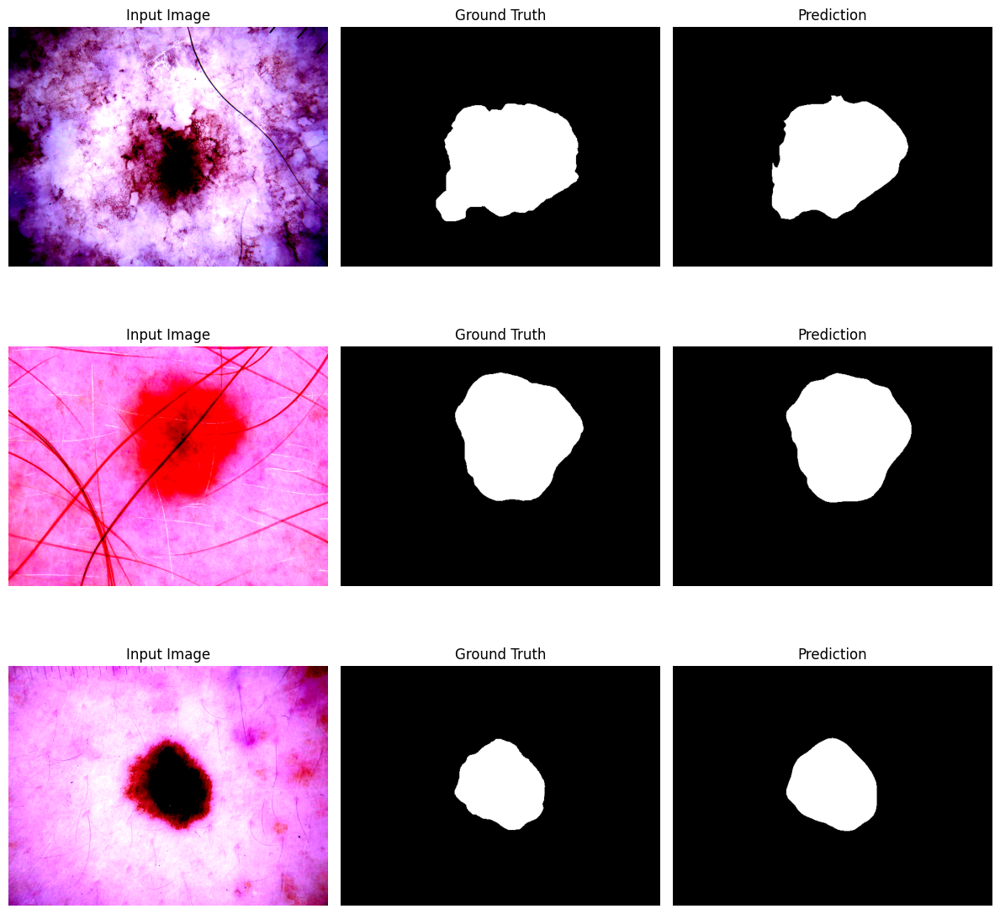

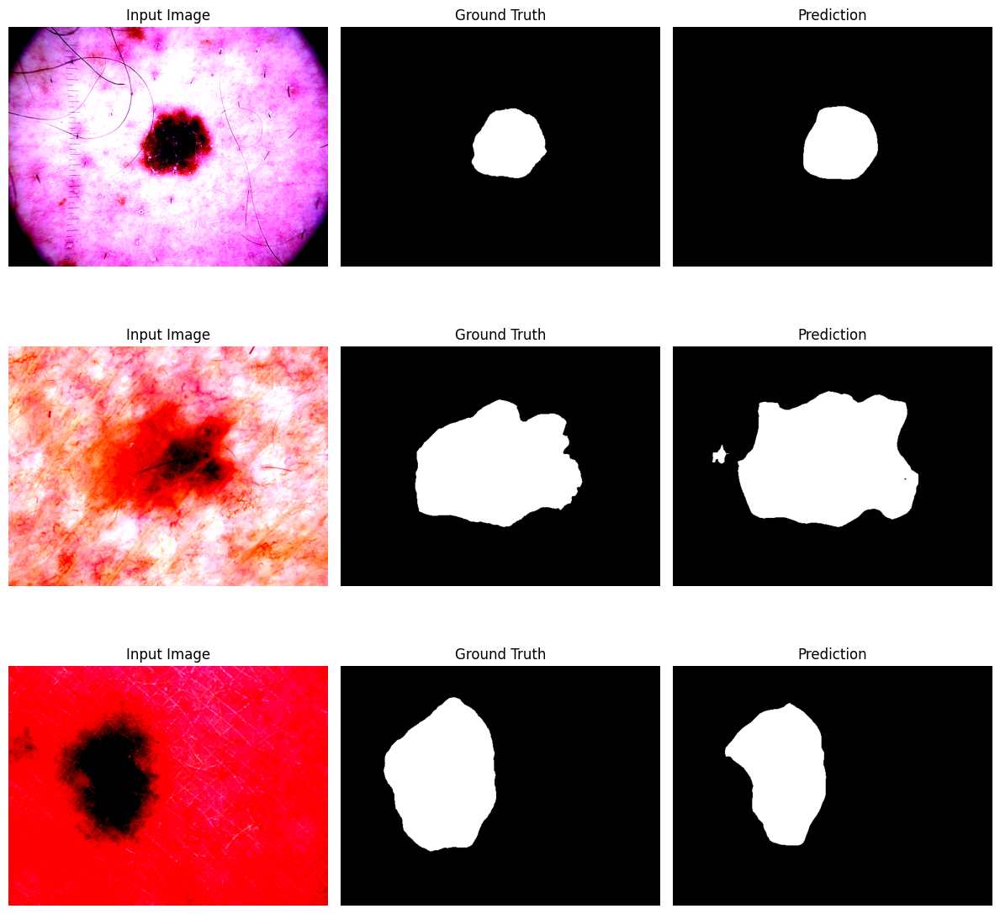

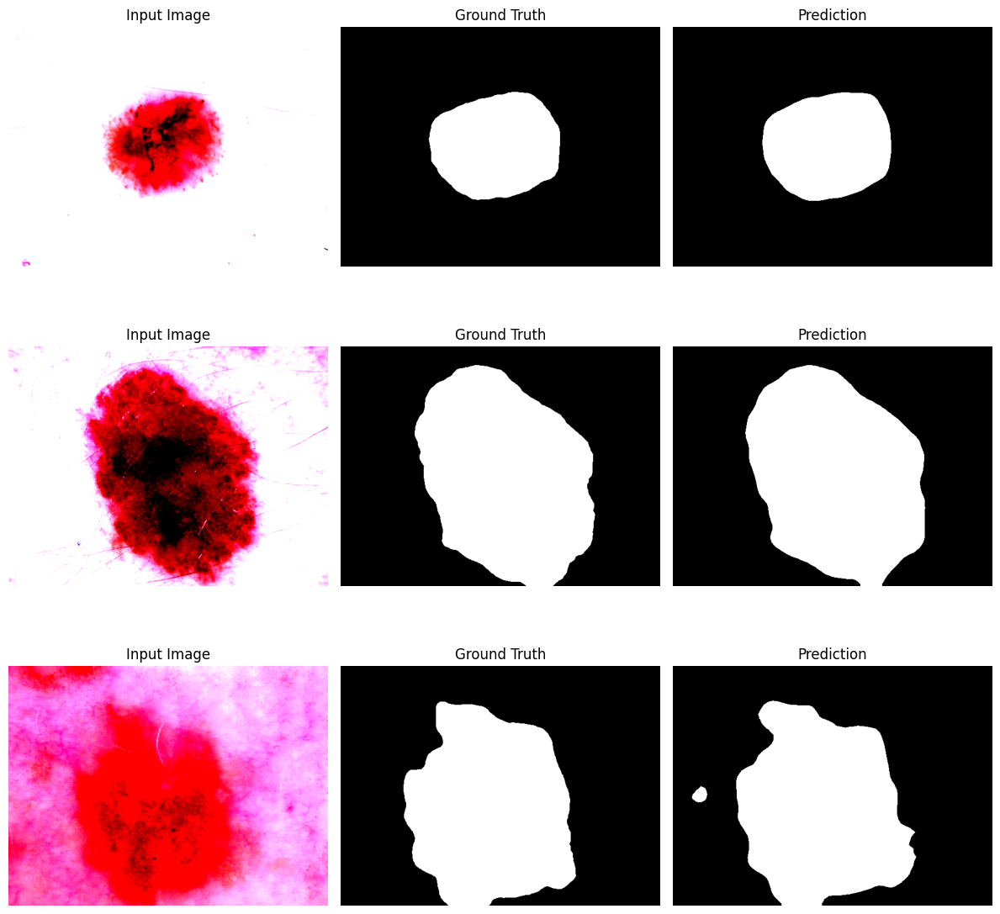

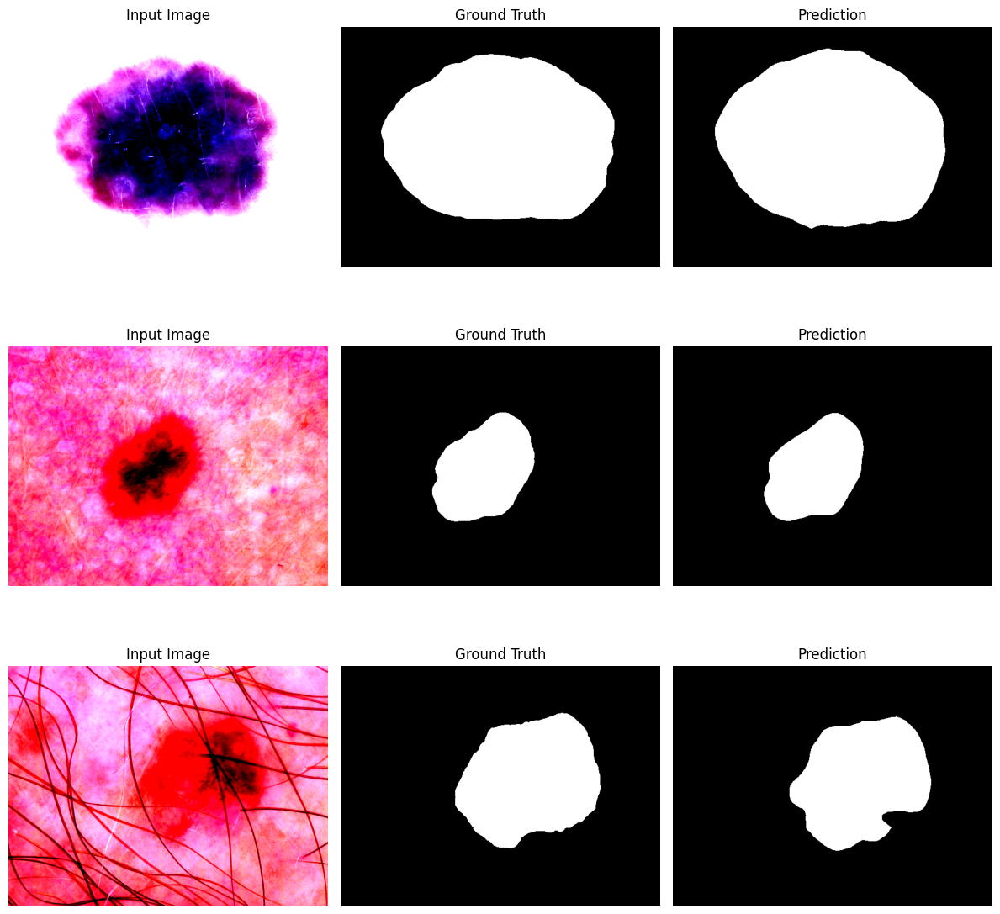

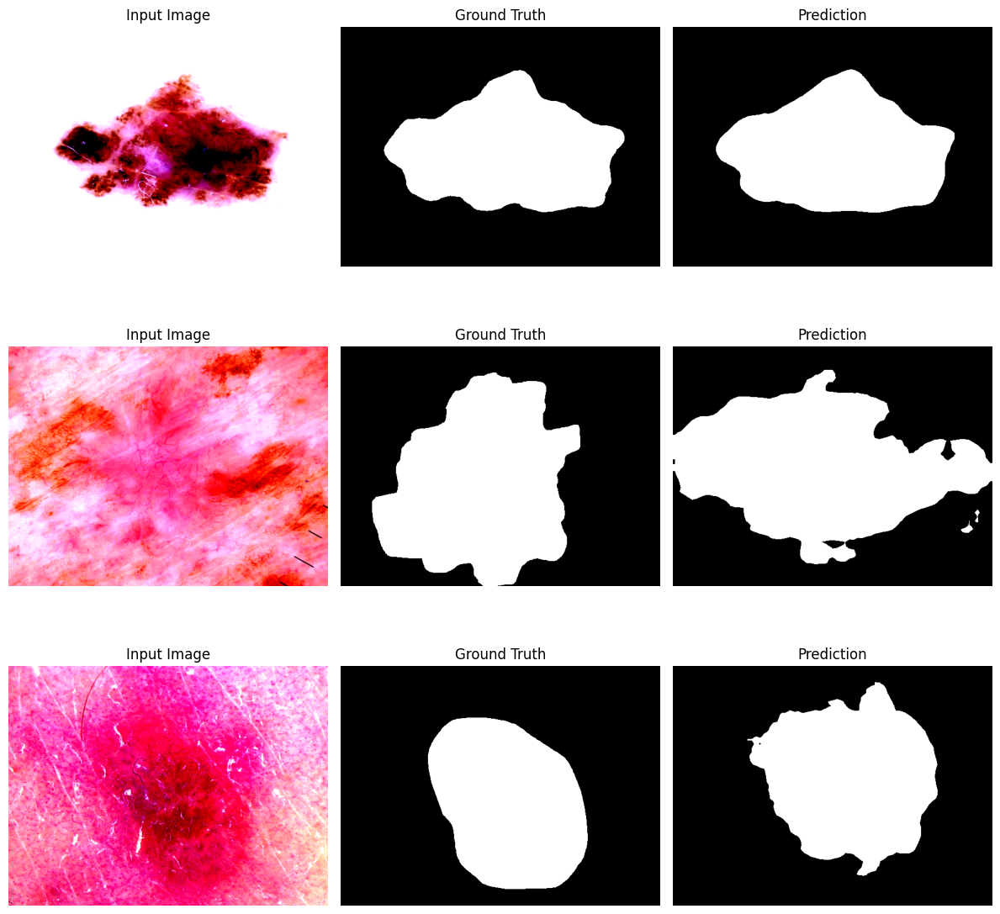

...

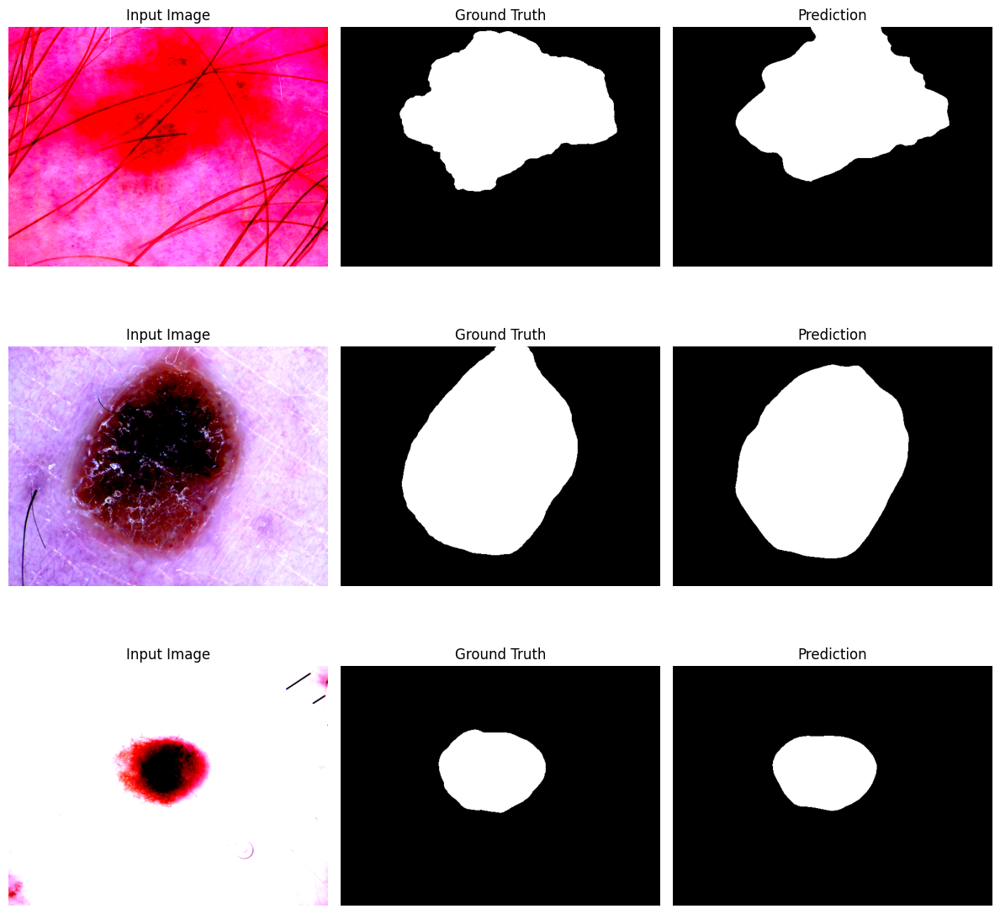

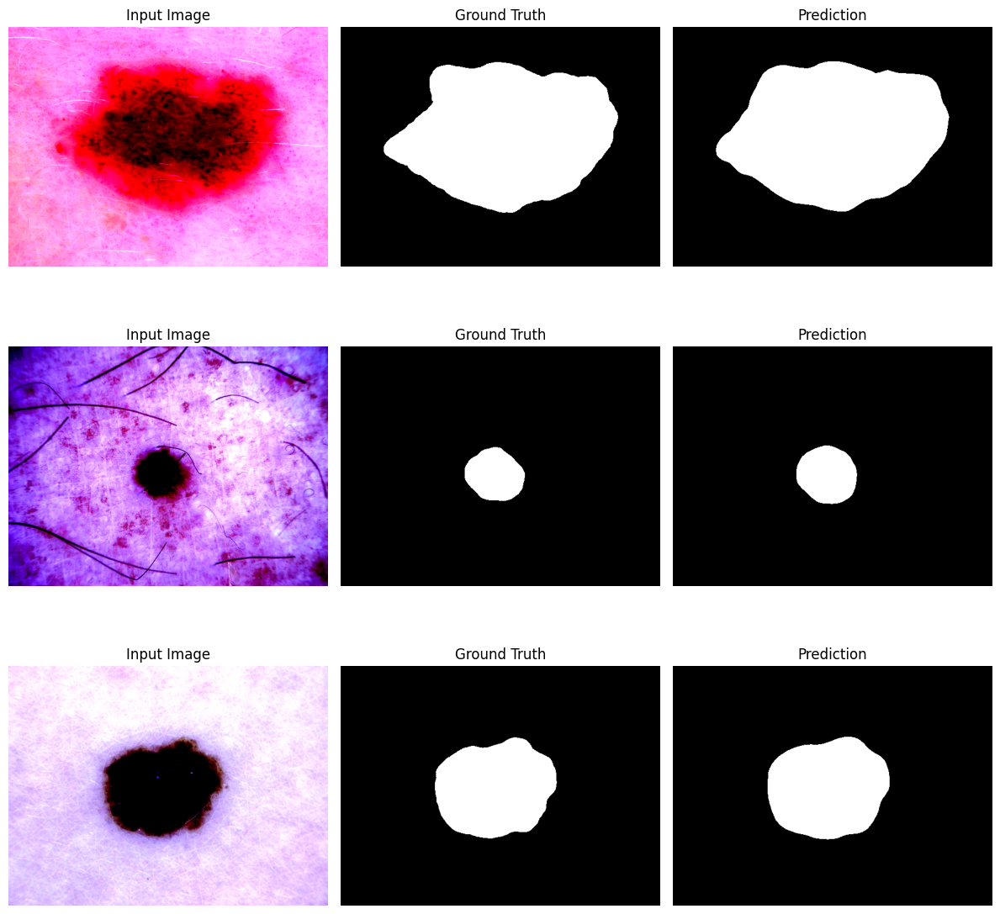

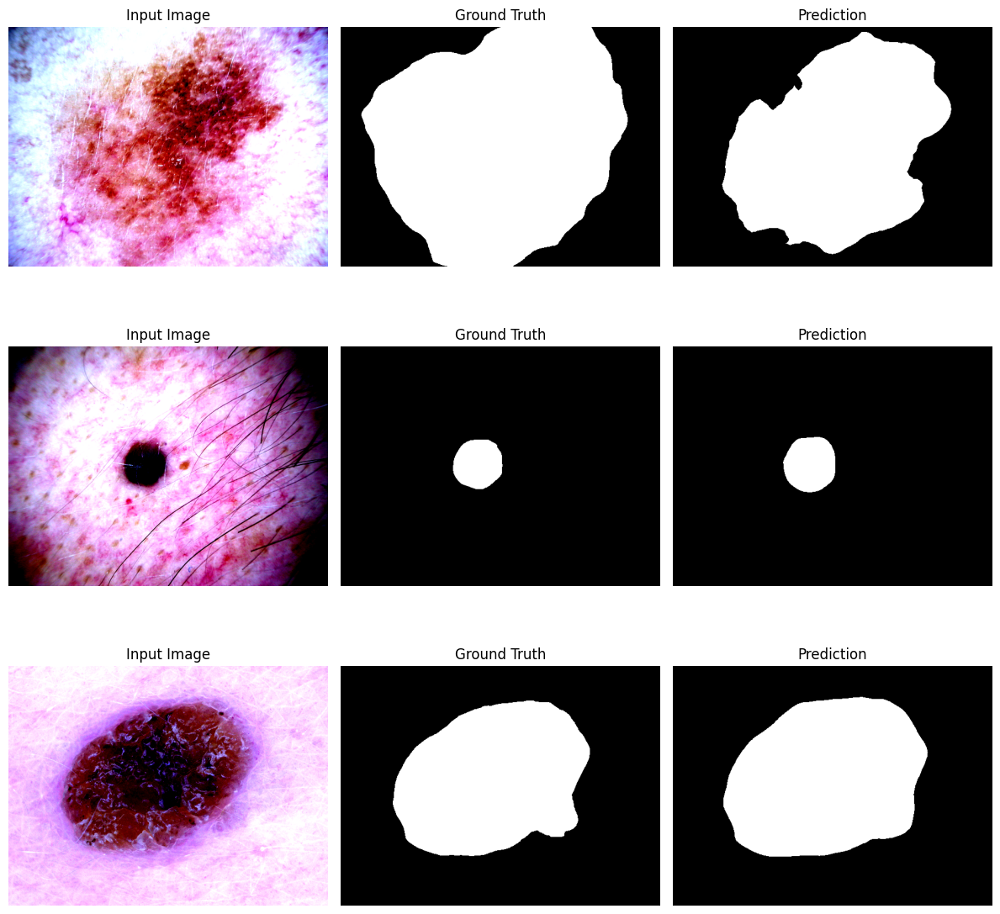

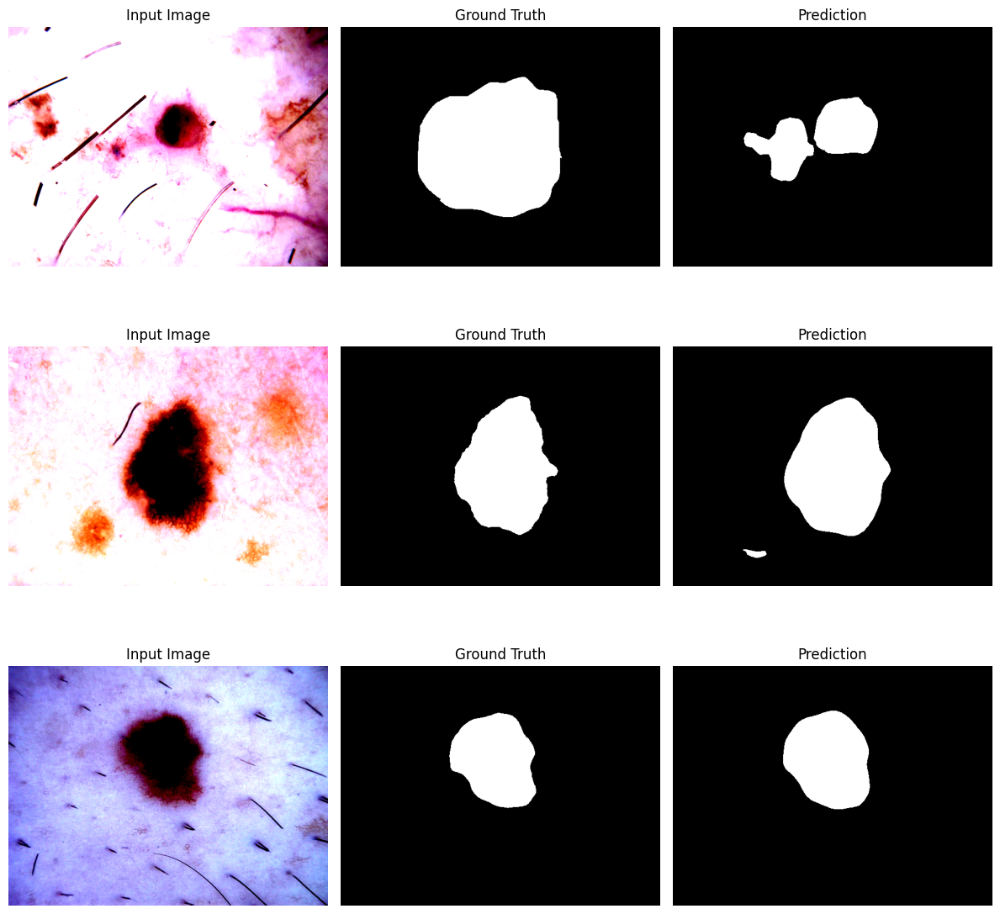

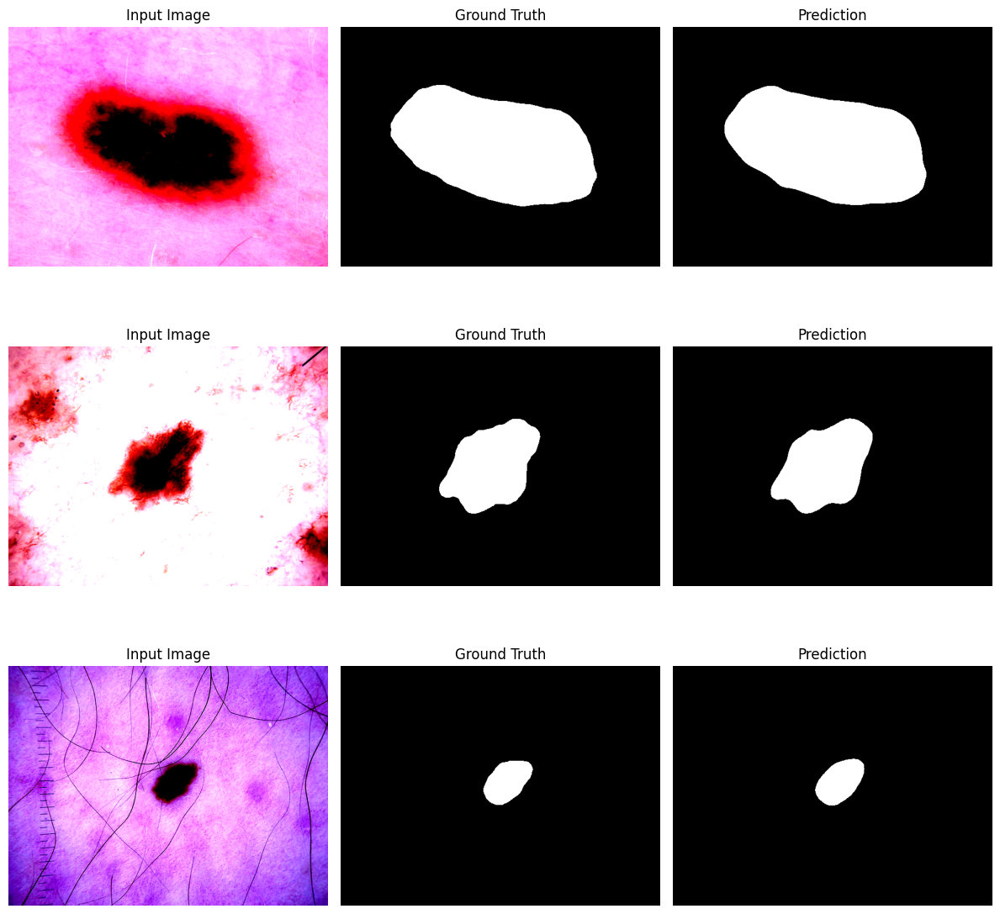

Average IOU: 0.8519
Average Dice Score: 0.9182


In [58]:
def evaluate_model(val_loader, model, device):
    model.eval()
    dice_scores = []
    iou = []

    with torch.no_grad():
        for i,(inputs, masks,label) in enumerate(val_loader):
            if i > 35:
                break
                
            inputs, masks,label = inputs.to(device), masks.to(device), label.to(device)

            # Forward pass
            outputs = model(inputs)['out']

            # Resize the output to match the mask size (if needed)
            outputs = torch.nn.functional.interpolate(outputs, size=masks.shape[1:], mode='bilinear', align_corners=False)

            # Calculate the Dice score
            pred_mask = torch.argmax(outputs, dim=1)  # Get the predicted mask
            dice = dice_score(pred_mask, masks)
            iou_score = calculateIOU(pred_mask, masks)
            iou.append(iou_score)
            dice_scores.append(dice)

            display_segmentation_examples(inputs, masks, outputs, num_examples=3)

    # Calculate the average Dice score
    avg_dice_score = np.mean(dice_scores)
    # avg_iou = np.mean(iou.cpu().numpy())
    iou_tensor = torch.tensor(iou)
    avg_iou = np.mean(iou_tensor.cpu().numpy())


    # avg_iou = np.mean(iou)
    print(f"Average IOU: {avg_iou:.4f}")
    print(f"Average Dice Score: {avg_dice_score:.4f}") 

evaluate_model(val_loader, model, device)

Confusion Matrix:


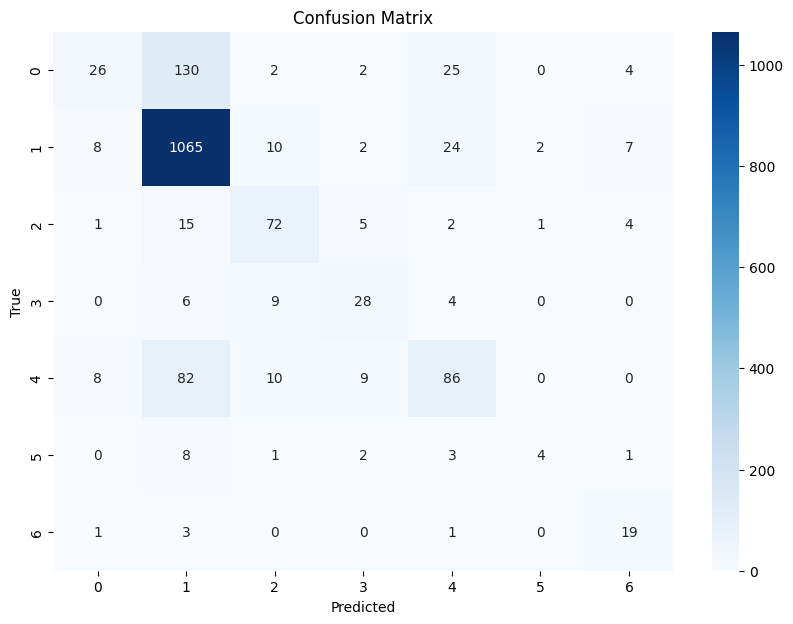

Validation Loss: 0.6461
Accuracy: 76.83%
Precision: 0.7432
Recall: 0.7683
F1-Score: 0.7338


(0.6460792952333853,
 76.8321513002364,
 0.7431872878071791,
 0.7683215130023641,
 0.7338127931066686,
 array([[  26,  130,    2,    2,   25,    0,    4],
        [   8, 1065,   10,    2,   24,    2,    7],
        [   1,   15,   72,    5,    2,    1,    4],
        [   0,    6,    9,   28,    4,    0,    0],
        [   8,   82,   10,    9,   86,    0,    0],
        [   0,    8,    1,    2,    3,    4,    1],
        [   1,    3,    0,    0,    1,    0,   19]]))

In [59]:
evaluate_classifier(val_loader, model, device, class_criterion)